**The notebook explains how to fine-tune a pre-trained stable diffusion model for generating new images. The process involves adapting the model to a new dataset, improving its performance while reducing training time. The goal is to leverage pre-existing knowledge from the model and train it further on custom images for enhanced results.**

** Setting Up the Environment**:
Here, we clone the Hugging Face diffusers library for working with state-of-the-art diffusion models. We then install the library and its dependencies to enable text-to-image generation.

In [ ]:
!cd /content/
!git clone https://github.com/huggingface/diffusers.git
!pip install ./diffusers
!pip install -U -r /content/diffusers/examples/text_to_image/requirements.txt

fatal: destination path 'diffusers' already exists and is not an empty directory.
Processing ./diffusers
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for diffusers: filename=diffusers-0.32.0.dev0-py3-none-any.whl size=2977364 sha256=5c3565f5d9ae8d70ed51f396b438ea45d4a4d1c3309e6cd536c9f09b499225f4
  Stored in directory: /tmp/pip-ephem-wheel-cache-gs0ybdki/wheels/95/c5/3b/e1b4269f8a2584de57e75f949a185b48fc4144e9a91fc9965a
Successfully built diffusers
  Attempting uninstall: diffusers
    Found existing installation: diffusers 0.32.0.dev0
    Uninstalling diffusers-0.32.0.dev0:
      Successfully uninstalled diffusers-0.32.0.dev0


**Configuring Accelerate for Mixed Precision**:

In [ ]:
!accelerate config default --mixed_precision fp16

Configuration already exists at /root/.cache/huggingface/accelerate/default_config.yaml, will not override. Run `accelerate config` manually or pass a different `save_location`.


Installing the Datasets Library

In [ ]:
!pip install datasets


** Loading a Dataset for Fine-Tuning with FFHQ dataset **

In [ ]:
from datasets import load_dataset

# Load the dataset from Hugging Face
dataset = load_dataset("irodkin/ffhq_with_llava_shorter_captions")

# Print information about the dataset
print(dataset)


Resolving data files:   0%|          | 0/34 [00:00<?, ?it/s]

Loading dataset shards:   0%|          | 0/23 [00:00<?, ?it/s]

DatasetDict({
    train: Dataset({
        features: ['image', 'text', 'conditioning_image'],
        num_rows: 40848
    })
})


**Installing Essential Libraries**

In [ ]:
!pip install diffusers torch datasets transformers accelerate


** Setting Up Environment Variables**

In [ ]:
import os

os.environ['MODEL_NAME'] = 'CompVis/stable-diffusion-v1-2'  # Keep the pre-trained model as is
os.environ['DATASET_NAME'] = 'irodkin/ffhq_with_llava_shorter_captions'  # New dataset name
os.environ['OUTPUT_DIR'] = 'sd_ffhq_shorter_captions_model_demo'  # New output directory name

** Logging into Hugging Face Hub**

In [ ]:
from huggingface_hub import notebook_login
notebook_login()

**Loading and Inspecting the Dataset**

In [ ]:
from datasets import load_dataset

dataset = load_dataset("irodkin/ffhq_with_llava_shorter_captions")
print(dataset['train'][0])  # This will show the first sample from the training set


Resolving data files:   0%|          | 0/34 [00:00<?, ?it/s]

Loading dataset shards:   0%|          | 0/23 [00:00<?, ?it/s]

{'image': <PIL.PngImagePlugin.PngImageFile image mode=RGB size=512x512 at 0x793FF41F2BC0>, 'text': 'The image features a blonde woman with blue eyes, wearing a green dress and a heart-shaped face. She has a small nose and a smile on her face. Her hair is long and blonde, and she is wearing earrings. The woman is sitting in front of a black background.', 'conditioning_image': <PIL.JpegImagePlugin.JpegImageFile image mode=L size=512x512 at 0x793FF422F640>}


  copy the train_to_image.py file and make the below changes in line 96:
  
  if args.validation_prompts is None or len(args.validation_prompts) == 0:
    prompt = "Default validation prompt: A person in a park."
else:
    prompt = args.validation_prompts[0]

In [ ]:
%cd diffusers/examples/text_to_image
!cp train_text_to_image.py /content/train_text_to_image_modified.py


[Errno 2] No such file or directory: 'diffusers/examples/text_to_image'
/content/diffusers/examples/text_to_image


**Launching the Training Process**:

Cell 9: Launching the Training Process
In this cell, we launch the training of the text-to-image model using the train_text_to_image.py script. The command includes a variety of hyperparameters and options:

--pretrained_model_name_or_path: Specifies the pre-trained model to use, in this case, CompVis/stable-diffusion-v1-2.
--dataset_name: The dataset (irodkin/ffhq_with_llava_shorter_captions) used for fine-tuning.
--caption_column & --image_column: Define the columns containing captions and images in the dataset.
Training Parameters: Batch size, gradient accumulation, learning rate, etc., are set for efficient training.
--validation_prompts: Text prompts to evaluate the model's performance during training.

In [ ]:
!accelerate launch train_text_to_image.py \
  --pretrained_model_name_or_path=CompVis/stable-diffusion-v1-2 \
  --dataset_name=irodkin/ffhq_with_llava_shorter_captions \
  --caption_column=text \
  --image_column=image \
  --use_ema \
  --resolution=512 \
  --center_crop \
  --random_flip \
  --train_batch_size=1 \
  --gradient_accumulation_steps=4 \
  --gradient_checkpointing \
  --mixed_precision=fp16 \
  --max_train_steps=400 \
  --learning_rate=1e-05 \
  --max_grad_norm=1 \
  --push_to_hub \
  --checkpointing_steps=100000 \
  --lr_scheduler=constant \
  --lr_warmup_steps=0 \
  --output_dir=sd_ffhq_shorter_captions_model_demo \
  --validation_prompts "A photorealistic portrait of a person in a park" "A photorealistic image of a person in a room"


2024-11-27 05:48:58.505434: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-11-27 05:48:58.523341: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-11-27 05:48:58.544904: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-11-27 05:48:58.551426: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-11-27 05:48:58.567031: I tensorflow/core/platform/cpu_feature_guar

**Running Inference and Creating Image Grid**:
In this cell, we use the fine-tuned Stable Diffusion model to generate four photorealistic images based on specific text prompts. The model takes the prompts and generates images in response. These images are then saved as individual files and arranged into a single grid for visualization.

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

Token indices sequence length is longer than the specified maximum sequence length for this model (90 > 77). Running this sequence through the model will result in indexing errors
The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ["on the man 's face , highlighting the wrinkles around his eyes ."]


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['a shallow depth of field , focusing sharply on her radiant face and softly blurring the colorful leaves in the background .']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['visible in the glass of the window , adding depth and realism to the scene .']


  0%|          | 0/50 [00:00<?, ?it/s]

The following part of your input was truncated because CLIP can only handle sequences up to 77 tokens: ['him . the background features distant rolling hills and a calm , clear blue sky , adding to the peaceful , natural setting .']


  0%|          | 0/50 [00:00<?, ?it/s]

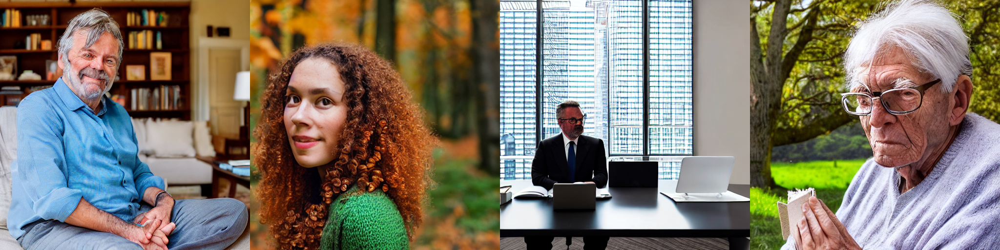

In [ ]:
# Stable Diffusion V1
from diffusers import StableDiffusionPipeline
import torch
from PIL import Image

model_path ="/content/sd_ffhq_shorter_captions_model_demo"   # Example path


pipe = StableDiffusionPipeline.from_pretrained(model_path, torch_dtype=torch.float16)
pipe.to("cuda")

# Run inference using updated realistic prompts
image1 = pipe(prompt="A hyper-realistic portrait of a middle-aged man with short, graying hair, wearing a casual blue shirt, sitting on a soft, plush, light beige sofa in a cozy living room. The warm evening sunlight filters through a large window, casting soft shadows on the floor, with detailed reflections on the wooden coffee table. The ambient light creates a soft, natural glow on the man's face, highlighting the wrinkles around his eyes.").images[0]
image1.save("ExperimentationPipeline_panel_1.png")

image2 = pipe(prompt="A photorealistic close-up of a young woman with rich, curly brown hair, standing amidst vibrant autumn foliage in a park. The sunlight pierces through the canopy of trees, casting dappled light on her face. She wears a cozy, dark green sweater, and the leaves around her are a brilliant mix of red, orange, and gold. The scene is captured with a shallow depth of field, focusing sharply on her radiant face and softly blurring the colorful leaves in the background.").images[0]
image2.save("ExperimentationPipeline_panel_2.png")

image3 = pipe(prompt="A highly detailed scene of a middle-aged man in a sharp, tailored black suit, sitting at a sleek, minimalist desk in a modern office. He is focused on his laptop, with a cityscape of towering skyscrapers visible through large, clear glass windows. The soft glow of natural light fills the room, creating a professional yet warm atmosphere. His reflection is subtly visible in the glass of the window, adding depth and realism to the scene.").images[0]
image3.save("ExperimentationPipeline_panel_3.png")

image4 = pipe(prompt="A hyper-realistic image of an elderly man with silver hair and glasses, wearing a soft, cream-colored sweater, sitting on a wooden bench under a large oak tree. He is deeply engrossed in a book, with the pages casting a soft shadow on his hands. The serene countryside setting is bathed in soft afternoon sunlight, with vibrant green grass and wildflowers surrounding him. The background features distant rolling hills and a calm, clear blue sky, adding to the peaceful, natural setting.").images[0]
image4.save("ExperimentationPipeline_panel_4.png")



# Image grid helper function from HuggingFace
def image_grid(imgs, rows, cols):
    assert len(imgs) == rows*cols

    w, h = imgs[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))
    grid_w, grid_h = grid.size

    for i, img in enumerate(imgs):
        grid.paste(img, box=(i%cols*w, i//cols*h))
    return grid

all_images = [image1, image2, image3, image4]
grid = image_grid(all_images, rows=1, cols=4)
grid

**Installing Required Libraries**

In [ ]:
!pip install datasets
!pip install torch torchvision


**Loading the Fine-Tuned Stable Diffusion Model**

In [ ]:
from diffusers import StableDiffusionPipeline
import torch
from torch.utils.data import DataLoader
from datasets import load_dataset
from tqdm import tqdm  # Import tqdm for progress bar

# Load the pre-trained model
model_path = "/content/sd_ffhq_shorter_captions_model_demo"  # Your fine-tuned model path
pipe = StableDiffusionPipeline.from_pretrained(model_path, torch_dtype=torch.float16)
pipe.to("cuda")

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

StableDiffusionPipeline {
  "_class_name": "StableDiffusionPipeline",
  "_diffusers_version": "0.32.0.dev0",
  "_name_or_path": "/content/sd_ffhq_shorter_captions_model_demo",
  "feature_extractor": [
    "transformers",
    "CLIPImageProcessor"
  ],
  "image_encoder": [
    null,
    null
  ],
  "requires_safety_checker": true,
  "safety_checker": [
    "stable_diffusion",
    "StableDiffusionSafetyChecker"
  ],
  "scheduler": [
    "diffusers",
    "PNDMScheduler"
  ],
  "text_encoder": [
    "transformers",
    "CLIPTextModel"
  ],
  "tokenizer": [
    "transformers",
    "CLIPTokenizer"
  ],
  "unet": [
    "diffusers",
    "UNet2DConditionModel"
  ],
  "vae": [
    "diffusers",
    "AutoencoderKL"
  ]
}


**Dataset Cleaning and Size Limiting
In this cell, you are performing two key actions on the dataset:**

Cleaning the dataset: You are keeping only the relevant columns (image and caption) and removing unnecessary ones (llama3.2 and gpt4o).
Limiting the dataset size: You are reducing the dataset to a manageable size by selecting only the first 1000 entries from the training set, which is useful for faster experimentation or resource constraints.

In [ ]:
# Load the dataset from HuggingFace
dataset = load_dataset("kargwalaryan/SynCap-Flickr8k")

# Clean the dataset by selecting only image and caption columns
dataset_cleaned = dataset.map(lambda x: {'image': x['image'], 'caption': x['caption']}, remove_columns=['llama3.2', 'gpt4o'])

# Limit dataset size (for example, use only first 1000 entries)
dataset_size_limit = 4000
# Use .select() on the entire dataset object to keep the split structure intact
dataset_cleaned = dataset_cleaned["train"].select(range(dataset_size_limit))

**Preparing DataLoader with Increased Batch Size**

In [ ]:
# Prepare DataLoader with increased batch size
def collate_fn(batch):
    images = [item["image"] for item in batch]
    captions = [item["caption"] for item in batch]
    return {"images": images, "captions": captions}

# Select the training data and apply a batch size
train_dataloader = DataLoader(dataset_cleaned, batch_size=4, collate_fn=collate_fn)

**Training Loop for Generating Images and Saving Model After Fine-Tuning**

In [ ]:
# Training loop
num_epochs = 1  # Set number of epochs, you can change this
total_steps = len(train_dataloader) * num_epochs  # Total steps to run

# Using tqdm to show the progress bar
for epoch in range(num_epochs):
    with tqdm(total=total_steps, desc=f"Training Epoch {epoch + 1}", dynamic_ncols=True) as pbar:
        for step, batch in enumerate(train_dataloader):
            images = batch["images"]
            captions = batch["captions"]

            # Pass the prompt (captions) to the model
            prompt = captions[0]  # Extract the first caption from the batch
            outputs = pipe(prompt=prompt, guidance_scale=7.5, num_inference_steps=50)

            # Save generated images or store them for review (optional)
            generated_image = outputs.images[0]
            generated_image.save(f"generated_image_epoch_{epoch}_step_{step}.png")

            # Update the progress bar
            pbar.update(1)

# Save the fine-tuned model after training
pipe.save_pretrained("/content/sd_flickr8k_finetuned_model")

Training Epoch 1:   0%|          | 0/1000 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   0%|          | 1/1000 [00:02<45:57,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   0%|          | 2/1000 [00:05<45:40,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   0%|          | 3/1000 [00:08<45:16,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   0%|          | 4/1000 [00:10<45:06,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   0%|          | 5/1000 [00:13<45:03,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   1%|          | 6/1000 [00:16<45:29,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   1%|          | 7/1000 [00:19<45:12,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   1%|          | 8/1000 [00:21<45:07,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   1%|          | 9/1000 [00:24<44:45,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   1%|          | 10/1000 [00:27<44:36,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   1%|          | 11/1000 [00:29<44:45,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   1%|          | 12/1000 [00:32<44:28,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   1%|▏         | 13/1000 [00:35<45:04,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   1%|▏         | 14/1000 [00:38<44:50,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   2%|▏         | 15/1000 [00:40<44:43,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   2%|▏         | 16/1000 [00:43<44:42,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.
Training Epoch 1:   2%|▏         | 17/1000 [00:46<44:31,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   2%|▏         | 18/1000 [00:48<44:16,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   2%|▏         | 19/1000 [00:51<44:07,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   2%|▏         | 20/1000 [00:54<43:46,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   2%|▏         | 21/1000 [00:56<43:50,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   2%|▏         | 22/1000 [00:59<44:01,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   2%|▏         | 23/1000 [01:02<43:48,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   2%|▏         | 24/1000 [01:05<43:33,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   2%|▎         | 25/1000 [01:07<43:52,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   3%|▎         | 26/1000 [01:10<44:26,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   3%|▎         | 27/1000 [01:13<44:00,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   3%|▎         | 28/1000 [01:15<43:50,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   3%|▎         | 29/1000 [01:18<43:53,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   3%|▎         | 30/1000 [01:21<43:54,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   3%|▎         | 31/1000 [01:24<43:52,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   3%|▎         | 32/1000 [01:26<43:38,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   3%|▎         | 33/1000 [01:29<43:24,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   3%|▎         | 34/1000 [01:32<43:29,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   4%|▎         | 35/1000 [01:34<43:39,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   4%|▎         | 36/1000 [01:37<43:17,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   4%|▎         | 37/1000 [01:40<43:35,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   4%|▍         | 38/1000 [01:43<43:32,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   4%|▍         | 39/1000 [01:45<43:46,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   4%|▍         | 40/1000 [01:48<43:24,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   4%|▍         | 41/1000 [01:51<43:19,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   4%|▍         | 42/1000 [01:53<43:28,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   4%|▍         | 43/1000 [01:56<43:15,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   4%|▍         | 44/1000 [01:59<43:06,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   4%|▍         | 45/1000 [02:02<43:17,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   5%|▍         | 46/1000 [02:04<42:54,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   5%|▍         | 47/1000 [02:07<42:35,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   5%|▍         | 48/1000 [02:10<42:46,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   5%|▍         | 49/1000 [02:12<42:43,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   5%|▌         | 50/1000 [02:15<42:36,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   5%|▌         | 51/1000 [02:18<42:37,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   5%|▌         | 52/1000 [02:20<42:25,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   5%|▌         | 53/1000 [02:23<42:17,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   5%|▌         | 54/1000 [02:26<42:08,  2.67s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   6%|▌         | 55/1000 [02:28<42:13,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   6%|▌         | 56/1000 [02:31<42:25,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   6%|▌         | 57/1000 [02:34<42:29,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   6%|▌         | 58/1000 [02:37<42:54,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   6%|▌         | 59/1000 [02:39<42:45,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   6%|▌         | 60/1000 [02:42<42:33,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   6%|▌         | 61/1000 [02:45<42:26,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   6%|▌         | 62/1000 [02:47<42:13,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   6%|▋         | 63/1000 [02:50<41:56,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   6%|▋         | 64/1000 [02:53<41:49,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   6%|▋         | 65/1000 [02:55<41:47,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   7%|▋         | 66/1000 [02:58<41:53,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   7%|▋         | 67/1000 [03:01<41:36,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   7%|▋         | 68/1000 [03:03<41:46,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   7%|▋         | 69/1000 [03:06<41:48,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   7%|▋         | 70/1000 [03:09<41:46,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   7%|▋         | 71/1000 [03:12<41:44,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   7%|▋         | 72/1000 [03:14<41:27,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   7%|▋         | 73/1000 [03:17<41:33,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   7%|▋         | 74/1000 [03:20<41:39,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   8%|▊         | 75/1000 [03:22<41:30,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   8%|▊         | 76/1000 [03:25<41:22,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   8%|▊         | 77/1000 [03:28<41:19,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   8%|▊         | 78/1000 [03:30<41:22,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   8%|▊         | 79/1000 [03:33<41:48,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   8%|▊         | 80/1000 [03:36<41:29,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   8%|▊         | 81/1000 [03:38<41:00,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   8%|▊         | 82/1000 [03:41<40:49,  2.67s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   8%|▊         | 83/1000 [03:44<40:59,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   8%|▊         | 84/1000 [03:47<40:53,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   8%|▊         | 85/1000 [03:49<40:55,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   9%|▊         | 86/1000 [03:52<40:42,  2.67s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   9%|▊         | 87/1000 [03:55<40:53,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   9%|▉         | 88/1000 [03:57<41:04,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   9%|▉         | 89/1000 [04:00<40:42,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   9%|▉         | 90/1000 [04:03<40:30,  2.67s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   9%|▉         | 91/1000 [04:05<40:25,  2.67s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   9%|▉         | 92/1000 [04:08<40:33,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   9%|▉         | 93/1000 [04:11<40:11,  2.66s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:   9%|▉         | 94/1000 [04:13<40:34,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  10%|▉         | 95/1000 [04:16<40:23,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  10%|▉         | 96/1000 [04:19<41:14,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  10%|▉         | 97/1000 [04:22<40:53,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  10%|▉         | 98/1000 [04:24<40:35,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  10%|▉         | 99/1000 [04:27<40:28,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  10%|█         | 100/1000 [04:30<40:31,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  10%|█         | 101/1000 [04:32<40:24,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  10%|█         | 102/1000 [04:35<40:14,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  10%|█         | 103/1000 [04:38<40:16,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  10%|█         | 104/1000 [04:40<40:18,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  10%|█         | 105/1000 [04:43<40:21,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  11%|█         | 106/1000 [04:46<40:09,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  11%|█         | 107/1000 [04:48<40:10,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  11%|█         | 108/1000 [04:51<40:09,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  11%|█         | 109/1000 [04:54<40:23,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  11%|█         | 110/1000 [04:57<40:21,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  11%|█         | 111/1000 [04:59<40:12,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  11%|█         | 112/1000 [05:02<40:01,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  11%|█▏        | 113/1000 [05:05<39:53,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  11%|█▏        | 114/1000 [05:07<40:05,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  12%|█▏        | 115/1000 [05:10<39:43,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  12%|█▏        | 116/1000 [05:13<39:28,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  12%|█▏        | 117/1000 [05:15<39:23,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  12%|█▏        | 118/1000 [05:18<39:54,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  12%|█▏        | 119/1000 [05:21<39:54,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  12%|█▏        | 120/1000 [05:24<39:42,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  12%|█▏        | 121/1000 [05:26<39:35,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  12%|█▏        | 122/1000 [05:29<39:20,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  12%|█▏        | 123/1000 [05:32<39:39,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  12%|█▏        | 124/1000 [05:34<39:35,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  12%|█▎        | 125/1000 [05:37<39:27,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  13%|█▎        | 126/1000 [05:40<39:12,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  13%|█▎        | 127/1000 [05:43<39:08,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  13%|█▎        | 128/1000 [05:45<39:10,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  13%|█▎        | 129/1000 [05:48<38:52,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  13%|█▎        | 130/1000 [05:50<38:38,  2.67s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  13%|█▎        | 131/1000 [05:53<39:12,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  13%|█▎        | 132/1000 [05:56<38:49,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  13%|█▎        | 133/1000 [05:59<38:53,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  13%|█▎        | 134/1000 [06:01<38:45,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  14%|█▎        | 135/1000 [06:04<38:56,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  14%|█▎        | 136/1000 [06:07<39:07,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  14%|█▎        | 137/1000 [06:10<39:13,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  14%|█▍        | 138/1000 [06:12<38:54,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  14%|█▍        | 139/1000 [06:15<38:55,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  14%|█▍        | 140/1000 [06:18<39:06,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  14%|█▍        | 141/1000 [06:20<39:08,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  14%|█▍        | 142/1000 [06:23<39:01,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  14%|█▍        | 143/1000 [06:26<38:30,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  14%|█▍        | 144/1000 [06:29<38:40,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  14%|█▍        | 145/1000 [06:31<38:33,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  15%|█▍        | 146/1000 [06:34<38:28,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  15%|█▍        | 147/1000 [06:37<38:51,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  15%|█▍        | 148/1000 [06:39<38:53,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  15%|█▍        | 149/1000 [06:42<38:51,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  15%|█▌        | 150/1000 [06:45<38:39,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  15%|█▌        | 151/1000 [06:48<38:25,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  15%|█▌        | 152/1000 [06:50<38:14,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  15%|█▌        | 153/1000 [06:53<38:23,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  15%|█▌        | 154/1000 [06:56<37:58,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  16%|█▌        | 155/1000 [06:58<38:00,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  16%|█▌        | 156/1000 [07:01<37:50,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  16%|█▌        | 157/1000 [07:04<37:53,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  16%|█▌        | 158/1000 [07:07<38:03,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  16%|█▌        | 159/1000 [07:09<37:55,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  16%|█▌        | 160/1000 [07:12<37:39,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  16%|█▌        | 161/1000 [07:15<37:31,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  16%|█▌        | 162/1000 [07:17<37:49,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  16%|█▋        | 163/1000 [07:20<37:31,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  16%|█▋        | 164/1000 [07:23<37:25,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  16%|█▋        | 165/1000 [07:25<37:31,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  17%|█▋        | 166/1000 [07:28<37:33,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  17%|█▋        | 167/1000 [07:31<37:13,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  17%|█▋        | 168/1000 [07:33<37:16,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  17%|█▋        | 169/1000 [07:36<37:06,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  17%|█▋        | 170/1000 [07:39<36:58,  2.67s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  17%|█▋        | 171/1000 [07:41<37:17,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  17%|█▋        | 172/1000 [07:44<37:07,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  17%|█▋        | 173/1000 [07:47<36:57,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  17%|█▋        | 174/1000 [07:49<36:45,  2.67s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  18%|█▊        | 175/1000 [07:52<36:45,  2.67s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  18%|█▊        | 176/1000 [07:55<37:00,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  18%|█▊        | 177/1000 [07:58<36:42,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  18%|█▊        | 178/1000 [08:00<36:44,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  18%|█▊        | 179/1000 [08:03<36:59,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  18%|█▊        | 180/1000 [08:06<36:54,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  18%|█▊        | 181/1000 [08:08<36:37,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  18%|█▊        | 182/1000 [08:11<36:41,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  18%|█▊        | 183/1000 [08:14<36:35,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  18%|█▊        | 184/1000 [08:16<36:42,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  18%|█▊        | 185/1000 [08:19<36:40,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  19%|█▊        | 186/1000 [08:22<36:26,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  19%|█▊        | 187/1000 [08:24<36:08,  2.67s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  19%|█▉        | 188/1000 [08:27<36:29,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  19%|█▉        | 189/1000 [08:30<36:29,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  19%|█▉        | 190/1000 [08:33<36:30,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  19%|█▉        | 191/1000 [08:35<36:39,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  19%|█▉        | 192/1000 [08:38<36:19,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  19%|█▉        | 193/1000 [08:41<36:40,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  19%|█▉        | 194/1000 [08:43<36:24,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  20%|█▉        | 195/1000 [08:46<36:13,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  20%|█▉        | 196/1000 [08:49<36:14,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  20%|█▉        | 197/1000 [08:52<36:33,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  20%|█▉        | 198/1000 [08:54<36:16,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  20%|█▉        | 199/1000 [08:57<36:01,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  20%|██        | 200/1000 [09:00<35:57,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  20%|██        | 201/1000 [09:02<36:06,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  20%|██        | 202/1000 [09:05<36:06,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  20%|██        | 203/1000 [09:08<35:59,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.
Training Epoch 1:  20%|██        | 204/1000 [09:10<35:22,  2.67s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  20%|██        | 205/1000 [09:13<35:24,  2.67s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  21%|██        | 206/1000 [09:16<35:36,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  21%|██        | 207/1000 [09:19<35:36,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  21%|██        | 208/1000 [09:21<35:31,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  21%|██        | 209/1000 [09:24<35:27,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  21%|██        | 210/1000 [09:27<35:46,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  21%|██        | 211/1000 [09:29<35:35,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  21%|██        | 212/1000 [09:32<35:25,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  21%|██▏       | 213/1000 [09:35<35:21,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  21%|██▏       | 214/1000 [09:37<35:25,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  22%|██▏       | 215/1000 [09:40<35:34,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  22%|██▏       | 216/1000 [09:43<35:22,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  22%|██▏       | 217/1000 [09:46<35:22,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  22%|██▏       | 218/1000 [09:48<35:09,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  22%|██▏       | 219/1000 [09:51<35:00,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  22%|██▏       | 220/1000 [09:54<35:07,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  22%|██▏       | 221/1000 [09:56<35:07,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  22%|██▏       | 222/1000 [09:59<34:58,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  22%|██▏       | 223/1000 [10:02<35:26,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  22%|██▏       | 224/1000 [10:05<35:10,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  22%|██▎       | 225/1000 [10:07<34:58,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  23%|██▎       | 226/1000 [10:10<34:41,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  23%|██▎       | 227/1000 [10:13<34:36,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  23%|██▎       | 228/1000 [10:15<34:50,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  23%|██▎       | 229/1000 [10:18<34:54,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  23%|██▎       | 230/1000 [10:21<35:03,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  23%|██▎       | 231/1000 [10:24<34:57,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  23%|██▎       | 232/1000 [10:26<34:55,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  23%|██▎       | 233/1000 [10:29<34:52,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  23%|██▎       | 234/1000 [10:32<34:40,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  24%|██▎       | 235/1000 [10:34<34:36,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  24%|██▎       | 236/1000 [10:37<34:33,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  24%|██▎       | 237/1000 [10:40<34:19,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  24%|██▍       | 238/1000 [10:42<34:02,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  24%|██▍       | 239/1000 [10:45<33:51,  2.67s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  24%|██▍       | 240/1000 [10:48<34:00,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  24%|██▍       | 241/1000 [10:51<34:13,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  24%|██▍       | 242/1000 [10:53<34:11,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  24%|██▍       | 243/1000 [10:56<34:12,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  24%|██▍       | 244/1000 [10:59<34:00,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  24%|██▍       | 245/1000 [11:01<34:09,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  25%|██▍       | 246/1000 [11:04<33:59,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  25%|██▍       | 247/1000 [11:07<33:46,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  25%|██▍       | 248/1000 [11:09<33:44,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  25%|██▍       | 249/1000 [11:12<33:47,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  25%|██▌       | 250/1000 [11:15<33:56,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  25%|██▌       | 251/1000 [11:18<33:58,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  25%|██▌       | 252/1000 [11:20<33:49,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  25%|██▌       | 253/1000 [11:23<33:43,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  25%|██▌       | 254/1000 [11:26<33:43,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  26%|██▌       | 255/1000 [11:28<33:46,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  26%|██▌       | 256/1000 [11:31<33:38,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  26%|██▌       | 257/1000 [11:34<33:33,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  26%|██▌       | 258/1000 [11:37<33:24,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  26%|██▌       | 259/1000 [11:39<33:20,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  26%|██▌       | 260/1000 [11:42<33:15,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  26%|██▌       | 261/1000 [11:45<33:14,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  26%|██▌       | 262/1000 [11:47<33:15,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  26%|██▋       | 263/1000 [11:50<33:17,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  26%|██▋       | 264/1000 [11:53<33:13,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  26%|██▋       | 265/1000 [11:55<33:07,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  27%|██▋       | 266/1000 [11:58<33:10,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  27%|██▋       | 267/1000 [12:01<33:07,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  27%|██▋       | 268/1000 [12:04<33:03,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  27%|██▋       | 269/1000 [12:06<32:48,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  27%|██▋       | 270/1000 [12:09<32:42,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  27%|██▋       | 271/1000 [12:12<32:54,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  27%|██▋       | 272/1000 [12:14<33:02,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  27%|██▋       | 273/1000 [12:17<33:01,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  27%|██▋       | 274/1000 [12:20<32:52,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  28%|██▊       | 275/1000 [12:23<32:45,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  28%|██▊       | 276/1000 [12:25<32:45,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  28%|██▊       | 277/1000 [12:28<32:45,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  28%|██▊       | 278/1000 [12:31<32:37,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  28%|██▊       | 279/1000 [12:33<32:28,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  28%|██▊       | 280/1000 [12:36<32:41,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  28%|██▊       | 281/1000 [12:39<32:30,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  28%|██▊       | 282/1000 [12:42<32:37,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  28%|██▊       | 283/1000 [12:44<32:21,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  28%|██▊       | 284/1000 [12:47<32:22,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  28%|██▊       | 285/1000 [12:50<32:13,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  29%|██▊       | 286/1000 [12:52<32:04,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  29%|██▊       | 287/1000 [12:55<32:00,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  29%|██▉       | 288/1000 [12:58<31:44,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  29%|██▉       | 289/1000 [13:00<31:53,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  29%|██▉       | 290/1000 [13:03<31:59,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  29%|██▉       | 291/1000 [13:06<32:00,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  29%|██▉       | 292/1000 [13:09<32:05,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  29%|██▉       | 293/1000 [13:11<32:03,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  29%|██▉       | 294/1000 [13:14<32:04,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  30%|██▉       | 295/1000 [13:17<32:06,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  30%|██▉       | 296/1000 [13:20<32:02,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  30%|██▉       | 297/1000 [13:22<31:47,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  30%|██▉       | 298/1000 [13:25<31:41,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  30%|██▉       | 299/1000 [13:28<31:25,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  30%|███       | 300/1000 [13:30<31:22,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  30%|███       | 301/1000 [13:33<31:26,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  30%|███       | 302/1000 [13:36<31:23,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  30%|███       | 303/1000 [13:38<31:10,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  30%|███       | 304/1000 [13:41<31:08,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  30%|███       | 305/1000 [13:44<31:19,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  31%|███       | 306/1000 [13:46<31:12,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  31%|███       | 307/1000 [13:49<30:59,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  31%|███       | 308/1000 [13:52<30:58,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  31%|███       | 309/1000 [13:54<30:55,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  31%|███       | 310/1000 [13:57<30:51,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  31%|███       | 311/1000 [14:00<30:44,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  31%|███       | 312/1000 [14:03<30:49,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  31%|███▏      | 313/1000 [14:05<30:42,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  31%|███▏      | 314/1000 [14:08<30:43,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  32%|███▏      | 315/1000 [14:11<30:55,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  32%|███▏      | 316/1000 [14:13<30:43,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  32%|███▏      | 317/1000 [14:16<30:42,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  32%|███▏      | 318/1000 [14:19<30:34,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  32%|███▏      | 319/1000 [14:22<30:54,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  32%|███▏      | 320/1000 [14:24<30:55,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  32%|███▏      | 321/1000 [14:27<30:51,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  32%|███▏      | 322/1000 [14:30<30:47,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  32%|███▏      | 323/1000 [14:32<30:49,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  32%|███▏      | 324/1000 [14:35<30:48,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  32%|███▎      | 325/1000 [14:38<30:35,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  33%|███▎      | 326/1000 [14:41<30:49,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  33%|███▎      | 327/1000 [14:43<30:46,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  33%|███▎      | 328/1000 [14:46<30:35,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  33%|███▎      | 329/1000 [14:49<30:17,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  33%|███▎      | 330/1000 [14:51<30:06,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  33%|███▎      | 331/1000 [14:54<29:52,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  33%|███▎      | 332/1000 [14:57<29:54,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  33%|███▎      | 333/1000 [14:59<29:46,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  33%|███▎      | 334/1000 [15:02<29:46,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  34%|███▎      | 335/1000 [15:05<29:51,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  34%|███▎      | 336/1000 [15:08<29:54,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  34%|███▎      | 337/1000 [15:10<30:12,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  34%|███▍      | 338/1000 [15:13<30:02,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  34%|███▍      | 339/1000 [15:16<30:03,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  34%|███▍      | 340/1000 [15:19<30:06,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  34%|███▍      | 341/1000 [15:21<30:12,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  34%|███▍      | 342/1000 [15:24<30:06,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  34%|███▍      | 343/1000 [15:27<29:50,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  34%|███▍      | 344/1000 [15:29<29:30,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  34%|███▍      | 345/1000 [15:32<29:31,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  35%|███▍      | 346/1000 [15:35<29:29,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  35%|███▍      | 347/1000 [15:38<29:40,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  35%|███▍      | 348/1000 [15:40<29:39,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  35%|███▍      | 349/1000 [15:43<29:34,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  35%|███▌      | 350/1000 [15:46<29:35,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  35%|███▌      | 351/1000 [15:49<29:27,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  35%|███▌      | 352/1000 [15:51<29:24,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  35%|███▌      | 353/1000 [15:54<29:08,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  35%|███▌      | 354/1000 [15:57<29:14,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  36%|███▌      | 355/1000 [15:59<29:09,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  36%|███▌      | 356/1000 [16:02<29:02,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  36%|███▌      | 357/1000 [16:05<28:56,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  36%|███▌      | 358/1000 [16:07<28:52,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  36%|███▌      | 359/1000 [16:10<29:02,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  36%|███▌      | 360/1000 [16:13<28:49,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  36%|███▌      | 361/1000 [16:16<28:55,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  36%|███▌      | 362/1000 [16:18<28:52,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  36%|███▋      | 363/1000 [16:21<29:03,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  36%|███▋      | 364/1000 [16:24<29:04,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  36%|███▋      | 365/1000 [16:27<28:43,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  37%|███▋      | 366/1000 [16:29<28:42,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  37%|███▋      | 367/1000 [16:32<28:32,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  37%|███▋      | 368/1000 [16:35<28:36,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  37%|███▋      | 369/1000 [16:37<28:34,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  37%|███▋      | 370/1000 [16:40<28:38,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  37%|███▋      | 371/1000 [16:43<28:38,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  37%|███▋      | 372/1000 [16:46<28:45,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  37%|███▋      | 373/1000 [16:48<28:23,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  37%|███▋      | 374/1000 [16:51<28:18,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  38%|███▊      | 375/1000 [16:54<28:07,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  38%|███▊      | 376/1000 [16:56<28:18,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  38%|███▊      | 377/1000 [16:59<28:02,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  38%|███▊      | 378/1000 [17:02<27:58,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  38%|███▊      | 379/1000 [17:05<28:05,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  38%|███▊      | 380/1000 [17:07<28:06,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  38%|███▊      | 381/1000 [17:10<27:54,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  38%|███▊      | 382/1000 [17:13<27:52,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  38%|███▊      | 383/1000 [17:15<27:47,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  38%|███▊      | 384/1000 [17:18<27:41,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  38%|███▊      | 385/1000 [17:21<27:45,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  39%|███▊      | 386/1000 [17:23<27:45,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  39%|███▊      | 387/1000 [17:26<27:39,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  39%|███▉      | 388/1000 [17:29<27:40,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  39%|███▉      | 389/1000 [17:32<27:32,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  39%|███▉      | 390/1000 [17:34<27:36,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  39%|███▉      | 391/1000 [17:37<27:25,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  39%|███▉      | 392/1000 [17:40<27:28,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  39%|███▉      | 393/1000 [17:42<27:34,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  39%|███▉      | 394/1000 [17:45<27:33,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  40%|███▉      | 395/1000 [17:48<27:21,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  40%|███▉      | 396/1000 [17:51<27:12,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  40%|███▉      | 397/1000 [17:53<27:11,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  40%|███▉      | 398/1000 [17:56<27:23,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  40%|███▉      | 399/1000 [17:59<27:15,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  40%|████      | 400/1000 [18:01<27:07,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  40%|████      | 401/1000 [18:04<26:59,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  40%|████      | 402/1000 [18:07<26:57,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  40%|████      | 403/1000 [18:10<26:45,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  40%|████      | 404/1000 [18:12<26:36,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  40%|████      | 405/1000 [18:15<26:27,  2.67s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  41%|████      | 406/1000 [18:17<26:26,  2.67s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  41%|████      | 407/1000 [18:20<26:44,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  41%|████      | 408/1000 [18:23<26:42,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  41%|████      | 409/1000 [18:26<26:41,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  41%|████      | 410/1000 [18:28<26:36,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  41%|████      | 411/1000 [18:31<26:42,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  41%|████      | 412/1000 [18:34<26:38,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  41%|████▏     | 413/1000 [18:37<26:30,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  41%|████▏     | 414/1000 [18:39<26:34,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  42%|████▏     | 415/1000 [18:42<26:31,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  42%|████▏     | 416/1000 [18:45<26:25,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  42%|████▏     | 417/1000 [18:47<26:23,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  42%|████▏     | 418/1000 [18:50<26:23,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  42%|████▏     | 419/1000 [18:53<26:22,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  42%|████▏     | 420/1000 [18:56<26:29,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  42%|████▏     | 421/1000 [18:58<26:12,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  42%|████▏     | 422/1000 [19:01<26:05,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  42%|████▏     | 423/1000 [19:04<25:59,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  42%|████▏     | 424/1000 [19:06<26:00,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  42%|████▎     | 425/1000 [19:09<25:52,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  43%|████▎     | 426/1000 [19:12<25:44,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  43%|████▎     | 427/1000 [19:14<25:34,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  43%|████▎     | 428/1000 [19:17<25:39,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  43%|████▎     | 429/1000 [19:20<25:46,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  43%|████▎     | 430/1000 [19:23<25:38,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  43%|████▎     | 431/1000 [19:25<25:40,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  43%|████▎     | 432/1000 [19:28<25:37,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  43%|████▎     | 433/1000 [19:31<25:39,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  43%|████▎     | 434/1000 [19:34<25:47,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  44%|████▎     | 435/1000 [19:36<25:28,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  44%|████▎     | 436/1000 [19:39<25:16,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  44%|████▎     | 437/1000 [19:42<25:43,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  44%|████▍     | 438/1000 [19:44<25:40,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  44%|████▍     | 439/1000 [19:47<25:38,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  44%|████▍     | 440/1000 [19:50<25:44,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  44%|████▍     | 441/1000 [19:53<25:35,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  44%|████▍     | 442/1000 [19:55<25:23,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  44%|████▍     | 443/1000 [19:58<25:17,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  44%|████▍     | 444/1000 [20:01<25:11,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  44%|████▍     | 445/1000 [20:04<25:11,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  45%|████▍     | 446/1000 [20:06<25:17,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  45%|████▍     | 447/1000 [20:09<25:09,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  45%|████▍     | 448/1000 [20:12<25:04,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  45%|████▍     | 449/1000 [20:14<24:53,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  45%|████▌     | 450/1000 [20:17<25:05,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  45%|████▌     | 451/1000 [20:20<25:02,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  45%|████▌     | 452/1000 [20:23<24:59,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  45%|████▌     | 453/1000 [20:25<24:55,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  45%|████▌     | 454/1000 [20:28<24:38,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  46%|████▌     | 455/1000 [20:31<24:29,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  46%|████▌     | 456/1000 [20:33<24:18,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  46%|████▌     | 457/1000 [20:36<24:17,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  46%|████▌     | 458/1000 [20:39<24:24,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  46%|████▌     | 459/1000 [20:42<24:23,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  46%|████▌     | 460/1000 [20:44<24:16,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  46%|████▌     | 461/1000 [20:47<24:05,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  46%|████▌     | 462/1000 [20:50<24:02,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  46%|████▋     | 463/1000 [20:52<24:00,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  46%|████▋     | 464/1000 [20:55<23:57,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  46%|████▋     | 465/1000 [20:58<23:59,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  47%|████▋     | 466/1000 [21:00<23:55,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  47%|████▋     | 467/1000 [21:03<23:54,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  47%|████▋     | 468/1000 [21:06<23:51,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  47%|████▋     | 469/1000 [21:08<23:47,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  47%|████▋     | 470/1000 [21:11<23:47,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  47%|████▋     | 471/1000 [21:14<23:50,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  47%|████▋     | 472/1000 [21:17<23:59,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  47%|████▋     | 473/1000 [21:19<23:55,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  47%|████▋     | 474/1000 [21:22<23:49,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  48%|████▊     | 475/1000 [21:25<23:49,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  48%|████▊     | 476/1000 [21:27<23:41,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  48%|████▊     | 477/1000 [21:30<23:36,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  48%|████▊     | 478/1000 [21:33<23:41,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  48%|████▊     | 479/1000 [21:36<23:47,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  48%|████▊     | 480/1000 [21:38<23:41,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  48%|████▊     | 481/1000 [21:41<23:41,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  48%|████▊     | 482/1000 [21:44<23:34,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  48%|████▊     | 483/1000 [21:47<23:32,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  48%|████▊     | 484/1000 [21:49<23:23,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  48%|████▊     | 485/1000 [21:52<23:13,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  49%|████▊     | 486/1000 [21:55<23:23,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  49%|████▊     | 487/1000 [21:57<23:20,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  49%|████▉     | 488/1000 [22:00<23:13,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  49%|████▉     | 489/1000 [22:03<23:03,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  49%|████▉     | 490/1000 [22:06<23:17,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  49%|████▉     | 491/1000 [22:08<23:09,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  49%|████▉     | 492/1000 [22:11<23:07,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  49%|████▉     | 493/1000 [22:14<23:04,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  49%|████▉     | 494/1000 [22:17<23:13,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  50%|████▉     | 495/1000 [22:19<23:18,  2.77s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  50%|████▉     | 496/1000 [22:22<23:09,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  50%|████▉     | 497/1000 [22:25<23:10,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  50%|████▉     | 498/1000 [22:28<23:04,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  50%|████▉     | 499/1000 [22:30<22:51,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  50%|█████     | 500/1000 [22:33<22:37,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  50%|█████     | 501/1000 [22:36<22:35,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  50%|█████     | 502/1000 [22:39<22:46,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  50%|█████     | 503/1000 [22:41<22:48,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  50%|█████     | 504/1000 [22:44<22:44,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  50%|█████     | 505/1000 [22:47<22:40,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  51%|█████     | 506/1000 [22:50<22:27,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  51%|█████     | 507/1000 [22:52<22:28,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  51%|█████     | 508/1000 [22:55<22:19,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  51%|█████     | 509/1000 [22:58<22:24,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  51%|█████     | 510/1000 [23:00<22:09,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  51%|█████     | 511/1000 [23:03<22:08,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  51%|█████     | 512/1000 [23:06<22:03,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  51%|█████▏    | 513/1000 [23:09<22:07,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  51%|█████▏    | 514/1000 [23:11<22:01,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  52%|█████▏    | 515/1000 [23:14<21:58,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  52%|█████▏    | 516/1000 [23:17<22:00,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  52%|█████▏    | 517/1000 [23:19<22:01,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  52%|█████▏    | 518/1000 [23:22<21:48,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  52%|█████▏    | 519/1000 [23:25<21:47,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  52%|█████▏    | 520/1000 [23:28<21:58,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  52%|█████▏    | 521/1000 [23:30<21:47,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  52%|█████▏    | 522/1000 [23:33<21:36,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  52%|█████▏    | 523/1000 [23:36<21:36,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  52%|█████▏    | 524/1000 [23:38<21:32,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  52%|█████▎    | 525/1000 [23:41<21:30,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  53%|█████▎    | 526/1000 [23:44<21:31,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  53%|█████▎    | 527/1000 [23:47<21:28,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  53%|█████▎    | 528/1000 [23:49<21:19,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  53%|█████▎    | 529/1000 [23:52<21:22,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  53%|█████▎    | 530/1000 [23:55<21:21,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  53%|█████▎    | 531/1000 [23:58<21:15,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  53%|█████▎    | 532/1000 [24:00<21:09,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  53%|█████▎    | 533/1000 [24:03<21:14,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  53%|█████▎    | 534/1000 [24:06<21:14,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  54%|█████▎    | 535/1000 [24:08<21:05,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  54%|█████▎    | 536/1000 [24:11<21:02,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  54%|█████▎    | 537/1000 [24:14<21:05,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  54%|█████▍    | 538/1000 [24:17<21:12,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  54%|█████▍    | 539/1000 [24:19<21:03,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  54%|█████▍    | 540/1000 [24:22<20:56,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  54%|█████▍    | 541/1000 [24:25<21:08,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  54%|█████▍    | 542/1000 [24:28<21:01,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  54%|█████▍    | 543/1000 [24:30<20:57,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  54%|█████▍    | 544/1000 [24:33<20:58,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  55%|█████▍    | 545/1000 [24:36<20:50,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  55%|█████▍    | 546/1000 [24:39<20:51,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  55%|█████▍    | 547/1000 [24:42<20:48,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  55%|█████▍    | 548/1000 [24:44<20:41,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  55%|█████▍    | 549/1000 [24:47<20:40,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  55%|█████▌    | 550/1000 [24:50<20:42,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  55%|█████▌    | 551/1000 [24:53<20:35,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  55%|█████▌    | 552/1000 [24:55<20:26,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  55%|█████▌    | 553/1000 [24:58<20:20,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  55%|█████▌    | 554/1000 [25:01<20:29,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  56%|█████▌    | 555/1000 [25:04<20:38,  2.78s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  56%|█████▌    | 556/1000 [25:06<20:33,  2.78s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  56%|█████▌    | 557/1000 [25:09<20:28,  2.77s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  56%|█████▌    | 558/1000 [25:12<20:17,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  56%|█████▌    | 559/1000 [25:15<20:10,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  56%|█████▌    | 560/1000 [25:17<20:04,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  56%|█████▌    | 561/1000 [25:20<19:56,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  56%|█████▌    | 562/1000 [25:23<19:56,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  56%|█████▋    | 563/1000 [25:25<19:58,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  56%|█████▋    | 564/1000 [25:28<19:58,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  56%|█████▋    | 565/1000 [25:31<19:56,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  57%|█████▋    | 566/1000 [25:34<19:52,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  57%|█████▋    | 567/1000 [25:36<19:50,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.
Training Epoch 1:  57%|█████▋    | 568/1000 [25:39<19:38,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  57%|█████▋    | 569/1000 [25:42<19:35,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  57%|█████▋    | 570/1000 [25:45<19:25,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  57%|█████▋    | 571/1000 [25:47<19:18,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  57%|█████▋    | 572/1000 [25:50<19:19,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  57%|█████▋    | 573/1000 [25:53<19:19,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  57%|█████▋    | 574/1000 [25:55<19:10,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  57%|█████▊    | 575/1000 [25:58<19:03,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  58%|█████▊    | 576/1000 [26:01<19:09,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  58%|█████▊    | 577/1000 [26:04<19:16,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  58%|█████▊    | 578/1000 [26:06<19:10,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  58%|█████▊    | 579/1000 [26:09<19:00,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  58%|█████▊    | 580/1000 [26:12<19:04,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  58%|█████▊    | 581/1000 [26:14<18:58,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  58%|█████▊    | 582/1000 [26:17<18:53,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  58%|█████▊    | 583/1000 [26:20<18:55,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  58%|█████▊    | 584/1000 [26:23<18:54,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  58%|█████▊    | 585/1000 [26:25<19:01,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  59%|█████▊    | 586/1000 [26:28<18:54,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  59%|█████▊    | 587/1000 [26:31<18:50,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  59%|█████▉    | 588/1000 [26:34<18:46,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  59%|█████▉    | 589/1000 [26:36<18:44,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  59%|█████▉    | 590/1000 [26:39<18:47,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  59%|█████▉    | 591/1000 [26:42<18:45,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  59%|█████▉    | 592/1000 [26:45<18:37,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  59%|█████▉    | 593/1000 [26:47<18:31,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  59%|█████▉    | 594/1000 [26:50<18:31,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  60%|█████▉    | 595/1000 [26:53<18:28,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.
Training Epoch 1:  60%|█████▉    | 596/1000 [26:55<18:08,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  60%|█████▉    | 597/1000 [26:58<18:07,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  60%|█████▉    | 598/1000 [27:01<18:13,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  60%|█████▉    | 599/1000 [27:04<18:03,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  60%|██████    | 600/1000 [27:06<18:02,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  60%|██████    | 601/1000 [27:09<17:54,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.
Training Epoch 1:  60%|██████    | 602/1000 [27:11<17:42,  2.67s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  60%|██████    | 603/1000 [27:14<17:43,  2.68s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  60%|██████    | 604/1000 [27:17<17:51,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  60%|██████    | 605/1000 [27:20<17:44,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  61%|██████    | 606/1000 [27:22<17:43,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  61%|██████    | 607/1000 [27:25<17:53,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  61%|██████    | 608/1000 [27:28<17:45,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  61%|██████    | 609/1000 [27:31<17:37,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  61%|██████    | 610/1000 [27:33<17:31,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  61%|██████    | 611/1000 [27:36<17:39,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  61%|██████    | 612/1000 [27:39<17:30,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  61%|██████▏   | 613/1000 [27:41<17:31,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  61%|██████▏   | 614/1000 [27:44<17:26,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  62%|██████▏   | 615/1000 [27:47<17:25,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  62%|██████▏   | 616/1000 [27:50<17:26,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  62%|██████▏   | 617/1000 [27:52<17:20,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  62%|██████▏   | 618/1000 [27:55<17:20,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  62%|██████▏   | 619/1000 [27:58<17:14,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  62%|██████▏   | 620/1000 [28:00<17:09,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  62%|██████▏   | 621/1000 [28:03<17:08,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  62%|██████▏   | 622/1000 [28:06<17:00,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  62%|██████▏   | 623/1000 [28:08<16:56,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  62%|██████▏   | 624/1000 [28:11<16:53,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  62%|██████▎   | 625/1000 [28:14<16:50,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  63%|██████▎   | 626/1000 [28:17<16:57,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  63%|██████▎   | 627/1000 [28:19<16:58,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  63%|██████▎   | 628/1000 [28:22<16:54,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  63%|██████▎   | 629/1000 [28:25<16:53,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  63%|██████▎   | 630/1000 [28:28<16:49,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  63%|██████▎   | 631/1000 [28:30<16:48,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  63%|██████▎   | 632/1000 [28:33<16:46,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  63%|██████▎   | 633/1000 [28:36<16:54,  2.77s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  63%|██████▎   | 634/1000 [28:39<16:50,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  64%|██████▎   | 635/1000 [28:41<16:45,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  64%|██████▎   | 636/1000 [28:44<16:36,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  64%|██████▎   | 637/1000 [28:47<16:39,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  64%|██████▍   | 638/1000 [28:50<16:35,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  64%|██████▍   | 639/1000 [28:52<16:29,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  64%|██████▍   | 640/1000 [28:55<16:28,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  64%|██████▍   | 641/1000 [28:58<16:21,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  64%|██████▍   | 642/1000 [29:01<16:16,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  64%|██████▍   | 643/1000 [29:03<16:14,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  64%|██████▍   | 644/1000 [29:06<16:11,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  64%|██████▍   | 645/1000 [29:09<16:03,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  65%|██████▍   | 646/1000 [29:11<16:10,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  65%|██████▍   | 647/1000 [29:14<16:05,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  65%|██████▍   | 648/1000 [29:17<15:58,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  65%|██████▍   | 649/1000 [29:20<15:50,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  65%|██████▌   | 650/1000 [29:22<15:44,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  65%|██████▌   | 651/1000 [29:25<15:43,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  65%|██████▌   | 652/1000 [29:28<15:44,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  65%|██████▌   | 653/1000 [29:30<15:37,  2.70s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  65%|██████▌   | 654/1000 [29:33<15:38,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  66%|██████▌   | 655/1000 [29:36<15:38,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  66%|██████▌   | 656/1000 [29:39<15:38,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  66%|██████▌   | 657/1000 [29:41<15:34,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  66%|██████▌   | 658/1000 [29:44<15:34,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  66%|██████▌   | 659/1000 [29:47<15:36,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  66%|██████▌   | 660/1000 [29:50<15:28,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  66%|██████▌   | 661/1000 [29:52<15:29,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  66%|██████▌   | 662/1000 [29:55<15:28,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  66%|██████▋   | 663/1000 [29:58<15:32,  2.77s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  66%|██████▋   | 664/1000 [30:01<15:22,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  66%|██████▋   | 665/1000 [30:03<15:15,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  67%|██████▋   | 666/1000 [30:06<15:09,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  67%|██████▋   | 667/1000 [30:09<15:07,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  67%|██████▋   | 668/1000 [30:11<15:10,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  67%|██████▋   | 669/1000 [30:14<15:01,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  67%|██████▋   | 670/1000 [30:17<15:06,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  67%|██████▋   | 671/1000 [30:20<15:00,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  67%|██████▋   | 672/1000 [30:22<15:01,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  67%|██████▋   | 673/1000 [30:25<14:51,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  67%|██████▋   | 674/1000 [30:28<14:51,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  68%|██████▊   | 675/1000 [30:31<14:42,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  68%|██████▊   | 676/1000 [30:33<14:41,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  68%|██████▊   | 677/1000 [30:36<14:42,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  68%|██████▊   | 678/1000 [30:39<14:35,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  68%|██████▊   | 679/1000 [30:41<14:37,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  68%|██████▊   | 680/1000 [30:44<14:39,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  68%|██████▊   | 681/1000 [30:47<14:33,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  68%|██████▊   | 682/1000 [30:50<14:27,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  68%|██████▊   | 683/1000 [30:52<14:25,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  68%|██████▊   | 684/1000 [30:55<14:22,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  68%|██████▊   | 685/1000 [30:58<14:29,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  69%|██████▊   | 686/1000 [31:01<14:24,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  69%|██████▊   | 687/1000 [31:03<14:19,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  69%|██████▉   | 688/1000 [31:06<14:14,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  69%|██████▉   | 689/1000 [31:09<14:20,  2.77s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  69%|██████▉   | 690/1000 [31:12<14:12,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  69%|██████▉   | 691/1000 [31:14<14:06,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  69%|██████▉   | 692/1000 [31:17<14:07,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  69%|██████▉   | 693/1000 [31:20<13:59,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  69%|██████▉   | 694/1000 [31:23<14:04,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  70%|██████▉   | 695/1000 [31:25<13:58,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  70%|██████▉   | 696/1000 [31:28<13:51,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  70%|██████▉   | 697/1000 [31:31<13:49,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  70%|██████▉   | 698/1000 [31:34<13:48,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  70%|██████▉   | 699/1000 [31:36<13:50,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  70%|███████   | 700/1000 [31:39<13:40,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  70%|███████   | 701/1000 [31:42<13:34,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  70%|███████   | 702/1000 [31:45<13:42,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  70%|███████   | 703/1000 [31:47<13:36,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  70%|███████   | 704/1000 [31:50<13:31,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  70%|███████   | 705/1000 [31:53<13:26,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  71%|███████   | 706/1000 [31:56<13:23,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  71%|███████   | 707/1000 [31:58<13:21,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  71%|███████   | 708/1000 [32:01<13:16,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  71%|███████   | 709/1000 [32:04<13:09,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  71%|███████   | 710/1000 [32:06<13:00,  2.69s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  71%|███████   | 711/1000 [32:09<13:05,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  71%|███████   | 712/1000 [32:12<13:06,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  71%|███████▏  | 713/1000 [32:15<13:04,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  71%|███████▏  | 714/1000 [32:17<13:03,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  72%|███████▏  | 715/1000 [32:20<13:00,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  72%|███████▏  | 716/1000 [32:23<12:52,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  72%|███████▏  | 717/1000 [32:25<12:46,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  72%|███████▏  | 718/1000 [32:28<12:49,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  72%|███████▏  | 719/1000 [32:31<12:49,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  72%|███████▏  | 720/1000 [32:34<12:46,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  72%|███████▏  | 721/1000 [32:36<12:40,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  72%|███████▏  | 722/1000 [32:39<12:37,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  72%|███████▏  | 723/1000 [32:42<12:34,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  72%|███████▏  | 724/1000 [32:45<12:34,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  72%|███████▎  | 725/1000 [32:47<12:25,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  73%|███████▎  | 726/1000 [32:50<12:26,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  73%|███████▎  | 727/1000 [32:53<12:24,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  73%|███████▎  | 728/1000 [32:56<12:25,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  73%|███████▎  | 729/1000 [32:58<12:19,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  73%|███████▎  | 730/1000 [33:01<12:14,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  73%|███████▎  | 731/1000 [33:04<12:09,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  73%|███████▎  | 732/1000 [33:06<12:08,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  73%|███████▎  | 733/1000 [33:09<12:05,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  73%|███████▎  | 734/1000 [33:12<12:02,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  74%|███████▎  | 735/1000 [33:14<11:58,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  74%|███████▎  | 736/1000 [33:17<12:01,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  74%|███████▎  | 737/1000 [33:20<12:02,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  74%|███████▍  | 738/1000 [33:23<11:59,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  74%|███████▍  | 739/1000 [33:26<11:55,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  74%|███████▍  | 740/1000 [33:28<11:50,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  74%|███████▍  | 741/1000 [33:31<11:51,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  74%|███████▍  | 742/1000 [33:34<11:47,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  74%|███████▍  | 743/1000 [33:36<11:43,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  74%|███████▍  | 744/1000 [33:39<11:40,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  74%|███████▍  | 745/1000 [33:42<11:39,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  75%|███████▍  | 746/1000 [33:45<11:39,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  75%|███████▍  | 747/1000 [33:48<11:36,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  75%|███████▍  | 748/1000 [33:50<11:33,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  75%|███████▍  | 749/1000 [33:53<11:26,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  75%|███████▌  | 750/1000 [33:56<11:28,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  75%|███████▌  | 751/1000 [33:59<11:25,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  75%|███████▌  | 752/1000 [34:01<11:24,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  75%|███████▌  | 753/1000 [34:04<11:17,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  75%|███████▌  | 754/1000 [34:07<11:15,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  76%|███████▌  | 755/1000 [34:09<11:11,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  76%|███████▌  | 756/1000 [34:12<11:06,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  76%|███████▌  | 757/1000 [34:15<11:04,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  76%|███████▌  | 758/1000 [34:18<11:05,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  76%|███████▌  | 759/1000 [34:20<10:59,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  76%|███████▌  | 760/1000 [34:23<10:55,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  76%|███████▌  | 761/1000 [34:26<10:50,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  76%|███████▌  | 762/1000 [34:29<10:50,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  76%|███████▋  | 763/1000 [34:31<10:49,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Potential NSFW content was detected in one or more images. A black image will be returned instead. Try again with a different prompt and/or seed.
Training Epoch 1:  76%|███████▋  | 764/1000 [34:34<10:38,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  76%|███████▋  | 765/1000 [34:37<10:40,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  77%|███████▋  | 766/1000 [34:40<10:42,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  77%|███████▋  | 767/1000 [34:42<10:40,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  77%|███████▋  | 768/1000 [34:45<10:37,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  77%|███████▋  | 769/1000 [34:48<10:29,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  77%|███████▋  | 770/1000 [34:50<10:28,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  77%|███████▋  | 771/1000 [34:53<10:28,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  77%|███████▋  | 772/1000 [34:56<10:29,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  77%|███████▋  | 773/1000 [34:59<10:25,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  77%|███████▋  | 774/1000 [35:01<10:19,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  78%|███████▊  | 775/1000 [35:04<10:19,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  78%|███████▊  | 776/1000 [35:07<10:20,  2.77s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  78%|███████▊  | 777/1000 [35:10<10:10,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  78%|███████▊  | 778/1000 [35:12<10:08,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  78%|███████▊  | 779/1000 [35:15<10:01,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  78%|███████▊  | 780/1000 [35:18<10:01,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  78%|███████▊  | 781/1000 [35:21<10:01,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  78%|███████▊  | 782/1000 [35:23<09:56,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  78%|███████▊  | 783/1000 [35:26<09:52,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  78%|███████▊  | 784/1000 [35:29<09:49,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  78%|███████▊  | 785/1000 [35:32<09:49,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  79%|███████▊  | 786/1000 [35:34<09:42,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  79%|███████▊  | 787/1000 [35:37<09:37,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  79%|███████▉  | 788/1000 [35:40<09:34,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  79%|███████▉  | 789/1000 [35:42<09:37,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  79%|███████▉  | 790/1000 [35:45<09:31,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  79%|███████▉  | 791/1000 [35:48<09:30,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  79%|███████▉  | 792/1000 [35:51<09:29,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  79%|███████▉  | 793/1000 [35:54<09:33,  2.77s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  79%|███████▉  | 794/1000 [35:56<09:26,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  80%|███████▉  | 795/1000 [35:59<09:21,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  80%|███████▉  | 796/1000 [36:02<09:19,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  80%|███████▉  | 797/1000 [36:04<09:17,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  80%|███████▉  | 798/1000 [36:07<09:16,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  80%|███████▉  | 799/1000 [36:10<09:08,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  80%|████████  | 800/1000 [36:13<09:03,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  80%|████████  | 801/1000 [36:15<08:58,  2.71s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  80%|████████  | 802/1000 [36:18<09:00,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  80%|████████  | 803/1000 [36:21<08:56,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  80%|████████  | 804/1000 [36:24<08:55,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  80%|████████  | 805/1000 [36:26<08:52,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  81%|████████  | 806/1000 [36:29<08:52,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  81%|████████  | 807/1000 [36:32<08:47,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  81%|████████  | 808/1000 [36:34<08:45,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  81%|████████  | 809/1000 [36:37<08:44,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  81%|████████  | 810/1000 [36:40<08:43,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  81%|████████  | 811/1000 [36:43<08:45,  2.78s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  81%|████████  | 812/1000 [36:46<08:45,  2.80s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  81%|████████▏ | 813/1000 [36:48<08:40,  2.78s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  81%|████████▏ | 814/1000 [36:51<08:32,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  82%|████████▏ | 815/1000 [36:54<08:30,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  82%|████████▏ | 816/1000 [36:57<08:25,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  82%|████████▏ | 817/1000 [36:59<08:24,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  82%|████████▏ | 818/1000 [37:02<08:20,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  82%|████████▏ | 819/1000 [37:05<08:19,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  82%|████████▏ | 820/1000 [37:08<08:17,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  82%|████████▏ | 821/1000 [37:10<08:13,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  82%|████████▏ | 822/1000 [37:13<08:07,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  82%|████████▏ | 823/1000 [37:16<08:05,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  82%|████████▏ | 824/1000 [37:19<08:03,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  82%|████████▎ | 825/1000 [37:21<08:03,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  83%|████████▎ | 826/1000 [37:24<08:00,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  83%|████████▎ | 827/1000 [37:27<07:55,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  83%|████████▎ | 828/1000 [37:30<07:53,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  83%|████████▎ | 829/1000 [37:32<07:47,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  83%|████████▎ | 830/1000 [37:35<07:46,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  83%|████████▎ | 831/1000 [37:38<07:47,  2.77s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  83%|████████▎ | 832/1000 [37:41<07:48,  2.79s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  83%|████████▎ | 833/1000 [37:44<07:41,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  83%|████████▎ | 834/1000 [37:46<07:38,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  84%|████████▎ | 835/1000 [37:49<07:34,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  84%|████████▎ | 836/1000 [37:52<07:30,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  84%|████████▎ | 837/1000 [37:54<07:28,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  84%|████████▍ | 838/1000 [37:57<07:29,  2.77s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  84%|████████▍ | 839/1000 [38:00<07:24,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  84%|████████▍ | 840/1000 [38:03<07:19,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  84%|████████▍ | 841/1000 [38:06<07:16,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  84%|████████▍ | 842/1000 [38:08<07:14,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  84%|████████▍ | 843/1000 [38:11<07:10,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  84%|████████▍ | 844/1000 [38:14<07:09,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  84%|████████▍ | 845/1000 [38:17<07:09,  2.77s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  85%|████████▍ | 846/1000 [38:19<07:09,  2.79s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  85%|████████▍ | 847/1000 [38:22<07:04,  2.78s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  85%|████████▍ | 848/1000 [38:25<06:59,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  85%|████████▍ | 849/1000 [38:28<06:59,  2.78s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  85%|████████▌ | 850/1000 [38:30<06:55,  2.77s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  85%|████████▌ | 851/1000 [38:33<06:49,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  85%|████████▌ | 852/1000 [38:36<06:44,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  85%|████████▌ | 853/1000 [38:39<06:42,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  85%|████████▌ | 854/1000 [38:41<06:41,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  86%|████████▌ | 855/1000 [38:44<06:36,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  86%|████████▌ | 856/1000 [38:47<06:31,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  86%|████████▌ | 857/1000 [38:49<06:28,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  86%|████████▌ | 858/1000 [38:52<06:29,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  86%|████████▌ | 859/1000 [38:55<06:25,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  86%|████████▌ | 860/1000 [38:58<06:25,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  86%|████████▌ | 861/1000 [39:01<06:23,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  86%|████████▌ | 862/1000 [39:03<06:24,  2.79s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  86%|████████▋ | 863/1000 [39:06<06:18,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  86%|████████▋ | 864/1000 [39:09<06:13,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  86%|████████▋ | 865/1000 [39:12<06:09,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  87%|████████▋ | 866/1000 [39:14<06:05,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  87%|████████▋ | 867/1000 [39:17<06:06,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  87%|████████▋ | 868/1000 [39:20<06:02,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  87%|████████▋ | 869/1000 [39:23<06:00,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  87%|████████▋ | 870/1000 [39:25<05:57,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  87%|████████▋ | 871/1000 [39:28<05:55,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  87%|████████▋ | 872/1000 [39:31<05:51,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  87%|████████▋ | 873/1000 [39:34<05:48,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  87%|████████▋ | 874/1000 [39:36<05:42,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  88%|████████▊ | 875/1000 [39:39<05:41,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  88%|████████▊ | 876/1000 [39:42<05:37,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  88%|████████▊ | 877/1000 [39:44<05:36,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  88%|████████▊ | 878/1000 [39:47<05:34,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  88%|████████▊ | 879/1000 [39:50<05:32,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  88%|████████▊ | 880/1000 [39:53<05:30,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  88%|████████▊ | 881/1000 [39:55<05:26,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  88%|████████▊ | 882/1000 [39:58<05:23,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  88%|████████▊ | 883/1000 [40:01<05:20,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  88%|████████▊ | 884/1000 [40:04<05:18,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  88%|████████▊ | 885/1000 [40:06<05:16,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  89%|████████▊ | 886/1000 [40:09<05:16,  2.78s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  89%|████████▊ | 887/1000 [40:12<05:13,  2.78s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  89%|████████▉ | 888/1000 [40:15<05:13,  2.80s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  89%|████████▉ | 889/1000 [40:18<05:11,  2.81s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  89%|████████▉ | 890/1000 [40:21<05:10,  2.82s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  89%|████████▉ | 891/1000 [40:23<05:04,  2.80s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  89%|████████▉ | 892/1000 [40:26<05:02,  2.80s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  89%|████████▉ | 893/1000 [40:29<04:58,  2.79s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  89%|████████▉ | 894/1000 [40:32<04:54,  2.78s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  90%|████████▉ | 895/1000 [40:35<04:54,  2.81s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  90%|████████▉ | 896/1000 [40:37<04:50,  2.79s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  90%|████████▉ | 897/1000 [40:40<04:45,  2.77s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  90%|████████▉ | 898/1000 [40:43<04:44,  2.79s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  90%|████████▉ | 899/1000 [40:46<04:41,  2.78s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  90%|█████████ | 900/1000 [40:48<04:38,  2.79s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  90%|█████████ | 901/1000 [40:51<04:35,  2.79s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  90%|█████████ | 902/1000 [40:54<04:32,  2.78s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  90%|█████████ | 903/1000 [40:57<04:29,  2.78s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  90%|█████████ | 904/1000 [40:59<04:26,  2.78s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  90%|█████████ | 905/1000 [41:02<04:25,  2.79s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  91%|█████████ | 906/1000 [41:05<04:21,  2.79s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  91%|█████████ | 907/1000 [41:08<04:19,  2.79s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  91%|█████████ | 908/1000 [41:11<04:16,  2.79s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  91%|█████████ | 909/1000 [41:13<04:15,  2.80s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  91%|█████████ | 910/1000 [41:16<04:11,  2.79s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  91%|█████████ | 911/1000 [41:19<04:08,  2.79s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  91%|█████████ | 912/1000 [41:22<04:03,  2.77s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  91%|█████████▏| 913/1000 [41:25<04:02,  2.79s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  91%|█████████▏| 914/1000 [41:27<04:00,  2.80s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  92%|█████████▏| 915/1000 [41:30<03:55,  2.77s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  92%|█████████▏| 916/1000 [41:33<03:53,  2.78s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  92%|█████████▏| 917/1000 [41:36<03:49,  2.77s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  92%|█████████▏| 918/1000 [41:38<03:47,  2.77s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  92%|█████████▏| 919/1000 [41:41<03:43,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  92%|█████████▏| 920/1000 [41:44<03:39,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  92%|█████████▏| 921/1000 [41:47<03:36,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  92%|█████████▏| 922/1000 [41:49<03:34,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  92%|█████████▏| 923/1000 [41:52<03:32,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  92%|█████████▏| 924/1000 [41:55<03:29,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  92%|█████████▎| 925/1000 [41:58<03:26,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  93%|█████████▎| 926/1000 [42:00<03:23,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  93%|█████████▎| 927/1000 [42:03<03:20,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  93%|█████████▎| 928/1000 [42:06<03:19,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  93%|█████████▎| 929/1000 [42:09<03:17,  2.78s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  93%|█████████▎| 930/1000 [42:12<03:14,  2.78s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  93%|█████████▎| 931/1000 [42:14<03:12,  2.79s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  93%|█████████▎| 932/1000 [42:17<03:11,  2.82s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  93%|█████████▎| 933/1000 [42:20<03:07,  2.80s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  93%|█████████▎| 934/1000 [42:23<03:02,  2.77s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  94%|█████████▎| 935/1000 [42:25<02:59,  2.77s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  94%|█████████▎| 936/1000 [42:28<02:57,  2.77s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  94%|█████████▎| 937/1000 [42:31<02:53,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  94%|█████████▍| 938/1000 [42:34<02:50,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  94%|█████████▍| 939/1000 [42:36<02:48,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  94%|█████████▍| 940/1000 [42:39<02:47,  2.79s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  94%|█████████▍| 941/1000 [42:42<02:43,  2.77s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  94%|█████████▍| 942/1000 [42:45<02:40,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  94%|█████████▍| 943/1000 [42:48<02:37,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  94%|█████████▍| 944/1000 [42:50<02:34,  2.77s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  94%|█████████▍| 945/1000 [42:53<02:31,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  95%|█████████▍| 946/1000 [42:56<02:28,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  95%|█████████▍| 947/1000 [42:59<02:26,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  95%|█████████▍| 948/1000 [43:01<02:24,  2.77s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  95%|█████████▍| 949/1000 [43:04<02:21,  2.77s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  95%|█████████▌| 950/1000 [43:07<02:18,  2.77s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  95%|█████████▌| 951/1000 [43:10<02:15,  2.77s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  95%|█████████▌| 952/1000 [43:13<02:13,  2.78s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  95%|█████████▌| 953/1000 [43:15<02:10,  2.78s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  95%|█████████▌| 954/1000 [43:18<02:07,  2.77s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  96%|█████████▌| 955/1000 [43:21<02:03,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  96%|█████████▌| 956/1000 [43:24<02:01,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  96%|█████████▌| 957/1000 [43:26<01:58,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  96%|█████████▌| 958/1000 [43:29<01:56,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  96%|█████████▌| 959/1000 [43:32<01:53,  2.77s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  96%|█████████▌| 960/1000 [43:35<01:50,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  96%|█████████▌| 961/1000 [43:37<01:47,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  96%|█████████▌| 962/1000 [43:40<01:44,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  96%|█████████▋| 963/1000 [43:43<01:41,  2.73s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  96%|█████████▋| 964/1000 [43:45<01:37,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  96%|█████████▋| 965/1000 [43:48<01:36,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  97%|█████████▋| 966/1000 [43:51<01:33,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  97%|█████████▋| 967/1000 [43:54<01:30,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  97%|█████████▋| 968/1000 [43:57<01:28,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  97%|█████████▋| 969/1000 [43:59<01:25,  2.77s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  97%|█████████▋| 970/1000 [44:02<01:22,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  97%|█████████▋| 971/1000 [44:05<01:19,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  97%|█████████▋| 972/1000 [44:07<01:16,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  97%|█████████▋| 973/1000 [44:10<01:14,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  97%|█████████▋| 974/1000 [44:13<01:11,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  98%|█████████▊| 975/1000 [44:16<01:08,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  98%|█████████▊| 976/1000 [44:19<01:06,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  98%|█████████▊| 977/1000 [44:21<01:02,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  98%|█████████▊| 978/1000 [44:24<01:00,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  98%|█████████▊| 979/1000 [44:27<00:58,  2.77s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  98%|█████████▊| 980/1000 [44:30<00:55,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  98%|█████████▊| 981/1000 [44:32<00:52,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  98%|█████████▊| 982/1000 [44:35<00:49,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  98%|█████████▊| 983/1000 [44:38<00:46,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  98%|█████████▊| 984/1000 [44:41<00:44,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  98%|█████████▊| 985/1000 [44:43<00:41,  2.78s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  99%|█████████▊| 986/1000 [44:46<00:39,  2.79s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  99%|█████████▊| 987/1000 [44:49<00:36,  2.80s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  99%|█████████▉| 988/1000 [44:52<00:33,  2.77s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  99%|█████████▉| 989/1000 [44:55<00:30,  2.78s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  99%|█████████▉| 990/1000 [44:57<00:27,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  99%|█████████▉| 991/1000 [45:00<00:24,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  99%|█████████▉| 992/1000 [45:03<00:21,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  99%|█████████▉| 993/1000 [45:05<00:19,  2.72s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1:  99%|█████████▉| 994/1000 [45:08<00:16,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1: 100%|█████████▉| 995/1000 [45:11<00:13,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1: 100%|█████████▉| 996/1000 [45:14<00:11,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1: 100%|█████████▉| 997/1000 [45:16<00:08,  2.74s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1: 100%|█████████▉| 998/1000 [45:19<00:05,  2.75s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1: 100%|█████████▉| 999/1000 [45:22<00:02,  2.76s/it]

  0%|          | 0/50 [00:00<?, ?it/s]

Training Epoch 1: 100%|██████████| 1000/1000 [45:25<00:00,  2.73s/it]


**Generate and Visualize Images Using Fine-Tuned Stable Diffusion Model**

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

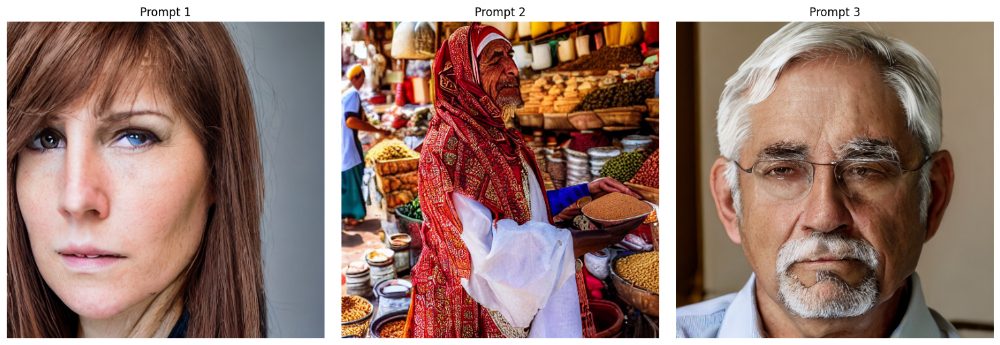

In [ ]:
import torch
from diffusers import StableDiffusionPipeline
import matplotlib.pyplot as plt

# Load the fine-tuned model
model_path = "/content/sd_flickr8k_finetuned_model"  # Path to your fine-tuned model
pipe = StableDiffusionPipeline.from_pretrained(model_path, torch_dtype=torch.float16)
pipe.to("cuda")

# Define the realistic prompts
prompts = [

    "A woman with brown hair, soft natural light, looking directly at camera",

    "Highly realistic portrait of a Moroccan spice trader in traditional clothing, standing in a bustling market, warm afternoon light, intricate fabric patterns, beads of sweat, weathered hands holding spice bags, rich cultural details, 4k photographic quality",

"Ultra-detailed realistic portrait of a middle-aged man with gray hair, wearing a white shirt, crisp photographic quality"
]


# Function to generate and plot the images
def generate_and_plot_images(prompts):
    fig, axes = plt.subplots(1, len(prompts), figsize=(15, 5))
    if len(prompts) == 1:
        axes = [axes]  # Ensure axes is iterable when only 1 prompt
    for i, prompt in enumerate(prompts):
        # Generate image from prompt
        outputs = pipe(prompt=prompt, guidance_scale=7.5, num_inference_steps=50)

        # Display the generated image
        generated_image = outputs.images[0]
        axes[i].imshow(generated_image)
        axes[i].axis('off')  # Hide axis
        axes[i].set_title(f"Prompt {i+1}")

    plt.tight_layout()
    plt.show()

# Generate and plot images based on prompts
generate_and_plot_images(prompts)


**GENERATING IMAGE AFTER UPSCALING**

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

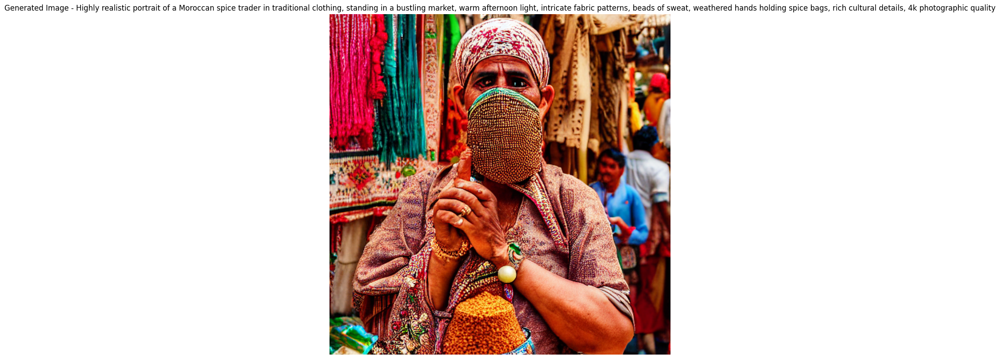

In [ ]:
import torch
from diffusers import StableDiffusionPipeline
import matplotlib.pyplot as plt
import cv2
import numpy as np
from PIL import Image

# Load the fine-tuned model
model_path = "/content/sd_flickr8k_finetuned_model"  # Path to your fine-tuned model
pipe = StableDiffusionPipeline.from_pretrained(model_path, torch_dtype=torch.float16)
pipe.to("cuda")

# Define the realistic prompt (one prompt)
prompt = "Highly realistic portrait of a Moroccan spice trader in traditional clothing, standing in a bustling market, warm afternoon light, intricate fabric patterns, beads of sweat, weathered hands holding spice bags, rich cultural details, 4k photographic quality"

# Function to generate and plot the image
def generate_and_plot_image(prompt):
    # Generate image from prompt
    outputs = pipe(prompt=prompt, guidance_scale=7.5, num_inference_steps=50)

    # Get the generated image
    generated_image = outputs.images[0]

    # Convert to numpy array for resizing
    generated_image_np = np.array(generated_image)

    # Resize the image to 2048x2048 using Lanczos interpolation
    upscaled_image_np = cv2.resize(generated_image_np, (2048, 2048), interpolation=cv2.INTER_LANCZOS4)

    # Convert back to PIL image
    upscaled_image = Image.fromarray(upscaled_image_np)

    # Display the upscaled image
    plt.figure(figsize=(10, 10))
    plt.imshow(upscaled_image)
    plt.axis('off')
    plt.title(f"Generated Image - {prompt}")
    plt.show()

# Generate and plot the image based on the prompt
generate_and_plot_image(prompt)


**UPSCALING RESIZING AND TESTING THE OUTPUT**

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

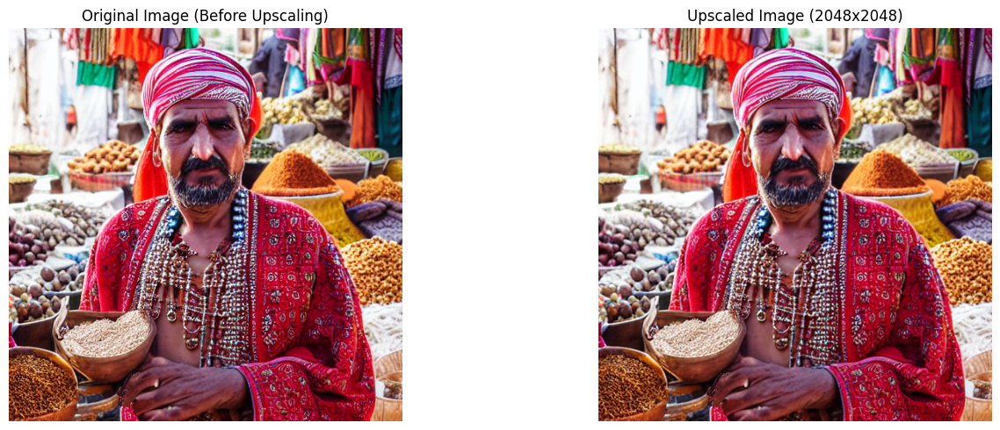

In [ ]:
import torch
from diffusers import StableDiffusionPipeline
import matplotlib.pyplot as plt
from PIL import Image
import cv2
import numpy as np

# Step 1: Load the fine-tuned model
model_path = "/content/sd_flickr8k_finetuned_model"  # Path to your fine-tuned model
pipe = StableDiffusionPipeline.from_pretrained(model_path, torch_dtype=torch.float16)
pipe.to("cuda")

# Step 2: Generate an image using a prompt
prompt = "Highly realistic portrait of a Moroccan spice trader in traditional clothing, standing in a bustling market, warm afternoon light, intricate fabric patterns, beads of sweat, weathered hands holding spice bags, rich cultural details, 4k photographic quality"

# Generate image using the prompt
outputs = pipe(prompt=prompt, guidance_scale=7.5, num_inference_steps=50)
generated_image = outputs.images[0]

# Step 3: Upscale using OpenCV's INTER_CUBIC method
# Convert PIL image to NumPy array
generated_image_np = np.array(generated_image)

# Upscale using OpenCV (INTER_CUBIC)
upscaled_image_np = cv2.resize(generated_image_np, None, fx=4, fy=4, interpolation=cv2.INTER_CUBIC)

# Step 4: Resize the upscaled image to 2048x2048 (to ensure final output size)
final_upscaled_image_np = cv2.resize(upscaled_image_np, (2048, 2048), interpolation=cv2.INTER_CUBIC)

# Convert back to PIL image
upscaled_image = Image.fromarray(final_upscaled_image_np)

# Step 5: Display both the original and upscaled images
fig, axes = plt.subplots(1, 2, figsize=(15, 5))
axes[0].imshow(generated_image)
axes[0].set_title("Original Image (Before Upscaling)")
axes[0].axis('off')

axes[1].imshow(upscaled_image)
axes[1].set_title("Upscaled Image (2048x2048)")
axes[1].axis('off')

plt.tight_layout()
plt.show()

# Save both images
generated_image.save("generated_image_before_upscaling.png")
upscaled_image.save("generated_image_after_upscaling_2048.png")


In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
